# Import Necessary Libraries

In [1]:
from PIL import Image
import torch
from datasets import load_dataset
from tqdm.notebook import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import transforms
from transformers import BertTokenizer
import torch.nn as nn
import torchvision.models as models
from transformers import BertModel


# Check for GPU

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#output the name of cuda device
if torch.cuda.is_available():
    print(torch.cuda.get_device_name(0))

NVIDIA GeForce RTX 3060 Laptop GPU


# Loading Dataset

In [3]:
base_path = 'pvqa/'

pvqa_dic_path = base_path + 'pvqa_dictionary.pkl'
test_img_id2idx_path = base_path + 'test_img_id2idx.pkl'
train_img_id2idx_path = base_path + 'train_img_id2idx.pkl'
val_img_id2idx_path = base_path + 'val_img_id2idx.pkl'

pvqa_dic_pkl = pd.read_pickle(pvqa_dic_path)
test_img_id2idx_pkl = pd.read_pickle(test_img_id2idx_path)
train_img_id2idx_pkl = pd.read_pickle(train_img_id2idx_path)
val_img_id2idx_pkl = pd.read_pickle(val_img_id2idx_path)

In [4]:
qas_base_path = base_path + 'qas/'

q2a_path = qas_base_path + 'q2a.pkl'
ans2lbl_path = qas_base_path + 'ans2label.pkl'
qid2a_path = qas_base_path + 'qid2a.pkl'
qid2q_path = qas_base_path + 'qid2q.pkl'
test_vqa_path = qas_base_path + 'test_vqa.pkl'
train_vqa_path = qas_base_path + 'train_vqa.pkl'
val_vqa_path = qas_base_path + 'val_vqa.pkl'
train_qa_path = qas_base_path + 'train/train_qa.pkl'
trainval_ans2lbl_path = qas_base_path + 'trainval_ans2label.pkl'
trainval_lbl2ans_path = qas_base_path + 'trainval_label2ans.pkl'

q2a_pairs = pd.read_pickle(q2a_path)
ans2lbl_pairs = pd.read_pickle(ans2lbl_path)
qid2a_pairs = pd.read_pickle(qid2a_path)
qid2q_pairs = pd.read_pickle(qid2q_path)
test_vqa_pairs = pd.read_pickle(test_vqa_path)
train_vqa_pairs = pd.read_pickle(train_vqa_path)
train_qa_pairs = pd.read_pickle(train_qa_path)
val_vqa_pairs = pd.read_pickle(val_vqa_path)
trainval_lbl2ans_pairs = pd.read_pickle(trainval_lbl2ans_path)
trainval_ans2lbl_pairs = pd.read_pickle(trainval_ans2lbl_path)

In [5]:
train_vqa_df = pd.DataFrame(train_vqa_pairs)
val_vqa_df = pd.DataFrame(val_vqa_pairs)
test_vqa_df = pd.DataFrame(test_vqa_pairs)

In [6]:
test_vqa_df

,answer_type,img_id,label,question_id,question_type,sent
0,other,test_0167,{'the histone subunits': 1},300167000,what,"What are positively charged, thus allowing th..."
1,other,test_0167,{'positively charged': 1},300167001,how,How are the histone subunits charged?
2,yes/no,test_0167,{'yes': 1},300167002,are,"Are the histone subunits positively charged, ..."
3,other,test_0099,{'the principal cellular alterations that char...,300099000,what,What are illustrated?
4,yes/no,test_0099,{'yes': 1},300099001,are,Are the principal cellular alterations that ch...
...,...,...,...,...,...,...
6756,other,test_0648,{'kidney': 1},300648002,what,What is present?
6757,yes/no,test_0648,{'yes': 1},300648003,is,Is kidney present?
6758,other,test_0648,{'sarcoidosis': 1},300648004,what,What is present?
6759,yes/no,test_0648,{'yes': 1},300648005,is,Is sarcoidosis present?


In [7]:
train_vqa_df

,answer_type,img_id,label,question_id,question_type,sent
0,other,train_0422,{'in the canals of hering': 1},100422000,where,Where are liver stem cells (oval cells) located?
1,other,train_0422,{'bile duct cells and canals of hering': 1},100422001,what,What are stained here with an immunohistochemi...
2,other,train_0422,{'an immunohistochemical stain': 1},100422002,what,What are bile duct cells and canals of Hering ...
3,yes/no,train_0422,{'yes': 1},100422003,are,Are bile duct cells and canals of Hering stain...
4,other,train_0986,{'an infarct in the brain': 1},100986000,what,What shows dissolution of the tissue?
...,...,...,...,...,...,...
19750,other,train_2794,{'urinary': 1},102794003,where,Where is this?
19751,other,train_2584,{'polyarteritis nodosa': 1},102584000,what,What does this image show?
19752,yes/no,train_2584,{'yes': 1},102584001,does,"Does this image show polyarteritis nodosa, kid..."
19753,yes/no,train_2584,{'no': 1},102584002,does,"Does cytomegaly show polyarteritis nodosa, kid..."


In [8]:
val_vqa_df

,answer_type,img_id,label,question_id,question_type,sent
0,other,val_0261,{'neutrophils': 1},200261000,what,What have lost their nuclei?
1,other,val_0261,{'neutrophils': 1},200261001,whose,Whose nuclei have been lost?
2,other,val_0261,{'their': 1},200261002,two,Two have lost whose nuclei ?
3,other,val_0178,{'the embolus': 1},200178000,what,What is composed of hematopoietic marrow and m...
4,other,val_0178,{'hematopoietic marrow and marrow fat cells': 1},200178001,what,What is the embolus composed of?
...,...,...,...,...,...,...
6274,other,val_0919,{'urinary': 1},200919005,where,Where is this?
6275,other,val_0849,{'polyarteritis nodosa': 1},200849000,what,What does this image show?
6276,yes/no,val_0849,{'yes': 1},200849001,does,"Does this image show polyarteritis nodosa, kid..."
6277,yes/no,val_0849,{'no': 1},200849002,does,Does metastatic carcinoma lung show polyarteri...


In [9]:
tr_q = list(train_vqa_df['sent'])
val_q = list(val_vqa_df['sent'])
ts_q = list(test_vqa_df['sent'])

tr_a = [q2a_pairs[each] for each in tr_q]
val_a = [q2a_pairs[each] for each in val_q]
ts_a = [q2a_pairs[each] for each in ts_q]

qs = [tr_q, val_q, ts_q]
ans = [tr_a, val_a, ts_a]

del tr_q, tr_a, ts_q, ts_a, val_q, val_a

In [10]:
val_lens = [len(each) for each in qs[1]]
tr_lens = [len(each) for each in qs[0]]
ts_lens = [len(each) for each in qs[2]]

print('Question with maximum length in validation set:', max(val_lens))
print('Question with minimum length in validation set:', min(val_lens))
print('Question with maximum length in training set:', max(tr_lens))
print('Question with minimum length in training set:', min(tr_lens))
print('Question with maximum length in test set:', max(ts_lens))
print('Question with minimum length in test set:', min(ts_lens))

del tr_lens, val_lens, ts_lens

Question with maximum length in validation set: 252
Question with minimum length in validation set: 8
Question with maximum length in training set: 255
Question with minimum length in training set: 9
Question with maximum length in test set: 264
Question with minimum length in test set: 8


In [11]:
idx = 0
ans2lbl_len = 4092
ans2lbl_keys = list(ans2lbl_pairs.keys())

for each in ans:
	for i in range(len(each)):
		if each[i] not in ans2lbl_keys:
			ans2lbl_pairs[each[i]] = ans2lbl_len + idx
			idx += 1

del ans2lbl_keys

In [12]:
num_classes = len(list(ans2lbl_pairs.keys()))
print(num_classes)
anss = list(ans2lbl_pairs.keys())
lbls = list(range(0, len(anss)))
ans2lbl_pairs = dict(zip(anss, lbls))

del anss, lbls

4645


In [13]:
dfs = [train_vqa_df, val_vqa_df, test_vqa_df]

del train_vqa_df, val_vqa_df, test_vqa_df

for i in range(len(dfs)):
    dfs[i]['question'] = dfs[i]['sent']
    dfs[i]['answer'] = pd.Series(ans[i])
    dfs[i]['label'] = pd.Series([ans2lbl_pairs[each] for each in ans[i]])

    if i == 0:
        dfs[i]['img_id'] = base_path + 'images/train/' + dfs[i]['img_id']
    elif i == 1:
        dfs[i]['img_id'] = base_path + 'images/val/' + dfs[i]['img_id']
    else:
        dfs[i]['img_id'] = base_path + 'images/test/' + dfs[i]['img_id']

    dfs[i].drop(['sent', 'answer_type', 'question_id', 'question_type'], axis=1, inplace=True)

In [14]:
dfs[0]

,img_id,label,question,answer
0,pvqa/images/train/train_0422,0,Where are liver stem cells (oval cells) located?,in the canals of hering
1,pvqa/images/train/train_0422,1,What are stained here with an immunohistochemi...,bile duct cells and canals of hering
2,pvqa/images/train/train_0422,2,What are bile duct cells and canals of Hering ...,an immunohistochemical stain
3,pvqa/images/train/train_0422,3,Are bile duct cells and canals of Hering stain...,yes
4,pvqa/images/train/train_0986,4,What shows dissolution of the tissue?,an infarct in the brain
...,...,...,...,...
19750,pvqa/images/train/train_2794,3203,Where is this?,urinary
19751,pvqa/images/train/train_2584,4115,What does this image show?,giant cells and fibrosis
19752,pvqa/images/train/train_2584,3,"Does this image show polyarteritis nodosa, kid...",yes
19753,pvqa/images/train/train_2584,6,"Does cytomegaly show polyarteritis nodosa, kid...",no


In [15]:
# Function to create label mappings dynamically
def create_label_mappings(dataframe):
    label_to_answer = {}
    for index, row in dataframe.iterrows():
        label_to_answer[row['label']] = row['answer']
    return label_to_answer

# Create label mappings dynamically
label_mappings = create_label_mappings(dfs[1])

# Test the label mappings
print(label_mappings)

{1282: 'neutrophils', 36: 'their', 3273: 'the embolus', 3274: 'hematopoietic marrow and marrow fat cells', 3: 'yes', 6: 'no', 150: 'two', 3275: 'two small pulmonary arterioles', 3276: 'laminated swirls ', 3277: 'the surrounding lung', 3278: 'immunoperoxidase staining', 3279: 'a predominantly perivascular cellular infiltrate', 3280: 'homogeneous or diffuse staining of nuclei', 3281: 'in sle', 3282: 'common', 3283: 'a nucleolar pattern', 3284: 'typical of antibodies', 3285: 'an immunofluorescence micrograph stained for igg', 3286: 'deposits of ig along the dermo-epidermal junction', 3287: 'extensive subcutaneous fibrosis', 3288: 'a clawlike flexion deformity', 3289: 'loss of blood supply', 3290: 'cutaneous ulcerations', 3291: 'the fibrous capsule', 138: 'the tumor', 3292: 'the parenchymal glands', 3293: ' atrophic and replaced by fibrous tissue', 3294: 'the ducts', 3295: 'eosinophilic mucin', 3296: 'bone marrow from an infant', 3297: 'parvovirus b19', 3298: 'with parvovirus b19', 100: 'o

# Data Loader

In [16]:
class VQADataset(torch.utils.data.Dataset):
    def __init__(self,
                df,
                text_processor,
                img_transform,
                shuffle_data=True):

        self.df = df
        self.text_processor = text_processor
        self.max_len = 32

        if shuffle_data:
            self.df = self.df.sample(frac=1).reset_index(drop=True)

        self.img_transform = img_transform

    def __len__(self) -> int:
        return len(self.df)

    def __getitem__(self, idx) -> tuple:
        image = Image.open(self.df.iloc[idx, 0] + '.jpg').convert("RGB")
        question = self.df.iloc[idx, 2]
        label = self.df.iloc[idx, 1]
        if self.img_transform:
            image = self.img_transform(image)
        encoding = self.text_processor(
                                  question,
                                  padding="max_length",
                                  truncation=True,
                                  max_length = self.max_len,
                                  return_tensors="pt"
                                  )
        # Remove batch dimension
        input_ids = encoding['input_ids'].squeeze(0)
        attention_mask = encoding['attention_mask'].squeeze(0)

        return image, input_ids, attention_mask, label

# Model Architecture

In [17]:
import torch
import torch.nn as nn
import torchvision.models as models
from transformers import BertModel

class Attention(nn.Module):
    def __init__(self, image_dim, question_dim, hidden_dim):
        super(Attention, self).__init__()
        self.image_fc = nn.Linear(image_dim, hidden_dim)
        self.question_fc = nn.Linear(question_dim, hidden_dim)
        self.fc = nn.Linear(hidden_dim, 1)

    def forward(self, image_features, question_features):
        # Linear transformations
        image_proj = self.image_fc(image_features)
        question_proj = self.question_fc(question_features).unsqueeze(1)
        
        # Combine projections
        combined_proj = torch.tanh(image_proj + question_proj)
        attention_weights = torch.softmax(self.fc(combined_proj), dim=1)
        
        # Weighted sum of image features
        attended_image_features = (attention_weights * image_features).sum(dim=1)
        
        return attended_image_features, attention_weights

class VQAModel(nn.Module):
    def __init__(self, num_answers):
        super(VQAModel, self).__init__()
        # Image feature extractor using VGG-19
        vgg = models.vgg19(pretrained=True)
        self.vgg_features = vgg.features
        self.vgg_classifier = nn.Sequential(*list(vgg.classifier.children())[:-1])
        self.vgg_fc = nn.Linear(4096, 512)

        # Question feature extractor using BERT
        self.bert = BertModel.from_pretrained('bert-base-uncased')
        self.bert_fc = nn.Linear(768, 512)

        # Attention layers
        self.attention1 = Attention(512, 512, 512)
        self.attention2 = Attention(512, 512, 512)

        # Combined classifier
        self.fc1 = nn.Linear(512 + 512, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, num_answers)

        self.dropout = nn.Dropout(0.5)
        self.relu = nn.ReLU()

    def forward(self, images, input_ids, attention_mask):
        # Image features
        with torch.no_grad():
            img_features = self.vgg_features(images)
        img_features = img_features.view(img_features.size(0), -1)
        img_features = self.vgg_classifier(img_features)
        img_features = self.vgg_fc(img_features)
        
        # Question features
        bert_output = self.bert(input_ids=input_ids, attention_mask=attention_mask)
        ques_features = self.bert_fc(bert_output.pooler_output)

        # Attention layers
        attended_img_features1, _ = self.attention1(img_features, ques_features)
        attended_img_features2, _ = self.attention2(attended_img_features1, ques_features)

        # Concatenate features
        combined_features = torch.cat((attended_img_features2, ques_features), dim=1)

        # Classification
        x = self.fc1(combined_features)
        x = self.relu(x)
        x = self.dropout(x)
        x = self.fc2(x)
        x = self.relu(x)
        x = self.dropout(x)
        output = self.fc3(x)

        return output

# Generate Inference

In [18]:
inference_df = dfs[1]
inference_df

,img_id,label,question,answer
0,pvqa/images/val/val_0261,1282,What have lost their nuclei?,neutrophils
1,pvqa/images/val/val_0261,1282,Whose nuclei have been lost?,neutrophils
2,pvqa/images/val/val_0261,36,Two have lost whose nuclei ?,their
3,pvqa/images/val/val_0178,3273,What is composed of hematopoietic marrow and m...,the embolus
4,pvqa/images/val/val_0178,3274,What is the embolus composed of?,hematopoietic marrow and marrow fat cells
...,...,...,...,...
6274,pvqa/images/val/val_0919,3203,Where is this?,urinary
6275,pvqa/images/val/val_0849,4115,What does this image show?,giant cells and fibrosis
6276,pvqa/images/val/val_0849,3,"Does this image show polyarteritis nodosa, kid...",yes
6277,pvqa/images/val/val_0849,6,Does metastatic carcinoma lung show polyarteri...,no


Length of inference_loader: 6279
Length of inference_dataset: 6279


c:\ProgramData\anaconda3\envs\pt\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\ProgramData\anaconda3\envs\pt\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


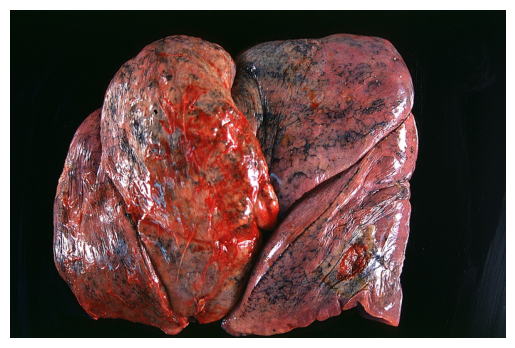

Question: Does this image show lung, squamous cell carcinoma?
Actual Answer: yes
Predicted Answer: yes
Index 0



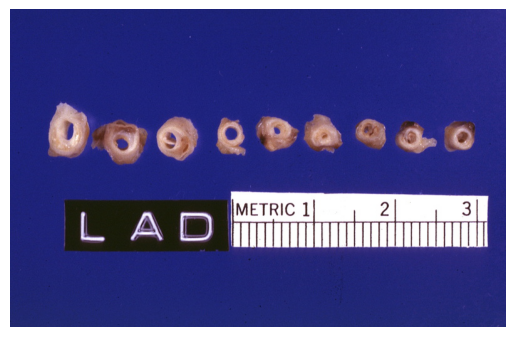

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 1



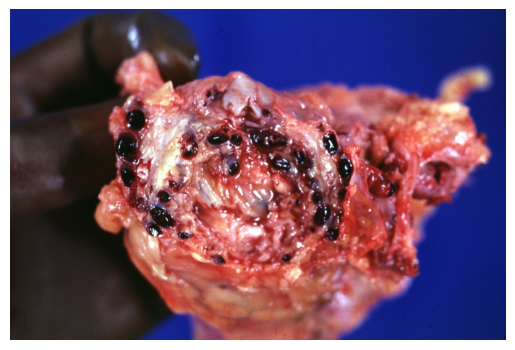

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 2



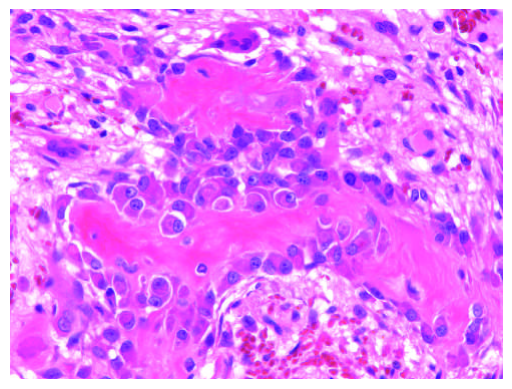

Question: What do the surrounding  spindle  cells  represent?
Actual Answer: the osteoprogenitor cells
Predicted Answer: heart
Index 3



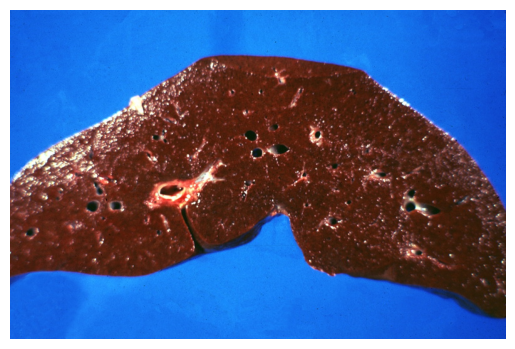

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 4



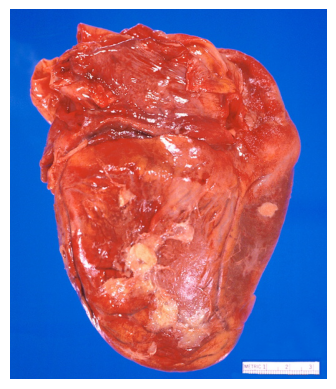

Question: Does this image show heart, myocardial infarction free wall, 6 days old, in a patient with diabetes mellitus and hypertension?
Actual Answer: yes
Predicted Answer: yes
Index 5



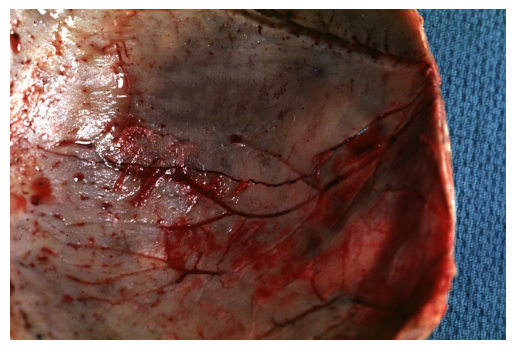

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 6



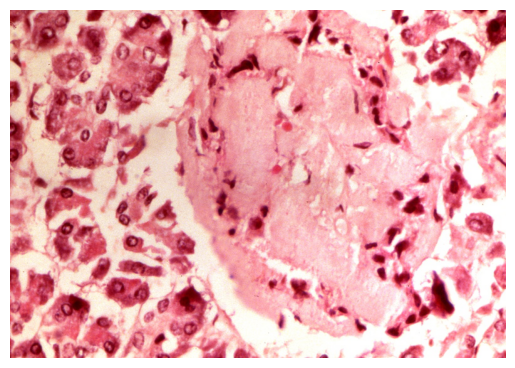

Question: Is lower chest and abdomen anterior present?
Actual Answer: no
Predicted Answer: no
Index 7



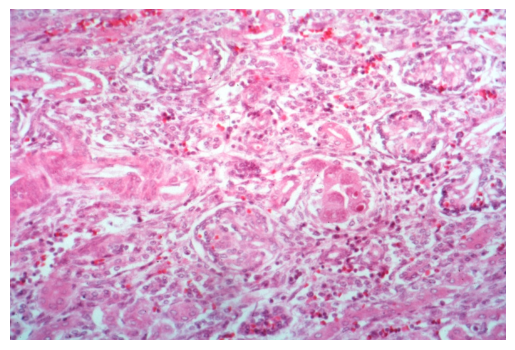

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 8



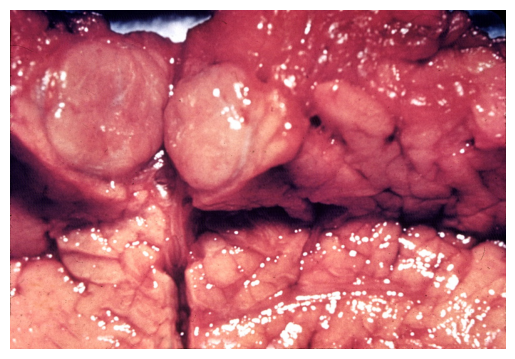

Question: What does this image show?
Actual Answer: giant cells and fibrosis
Predicted Answer: giant cells and fibrosis
Index 9



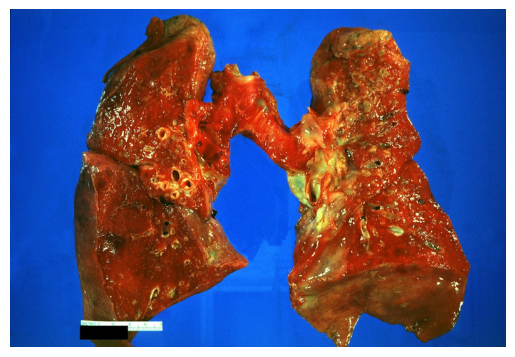

Question: Where is this?
Actual Answer: urinary
Predicted Answer: giant cells and fibrosis
Index 10



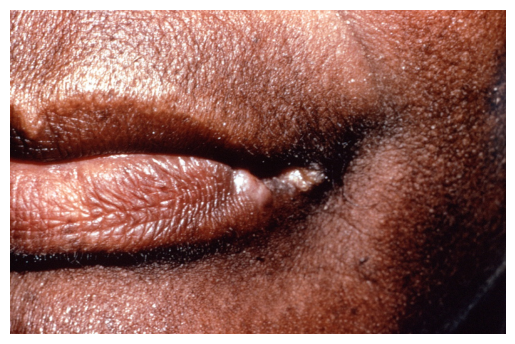

Question: What is present ?
Actual Answer: liver
Predicted Answer: sarcoidosis
Index 11



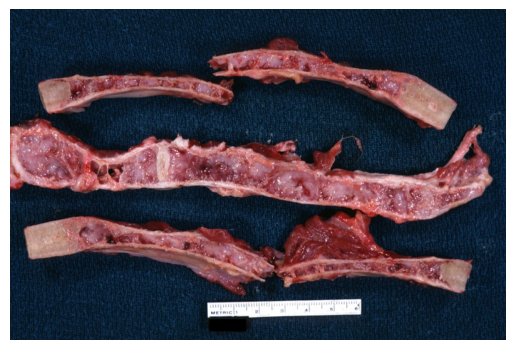

Question: What does this image show?
Actual Answer: giant cells and fibrosis
Predicted Answer: giant cells and fibrosis
Index 12



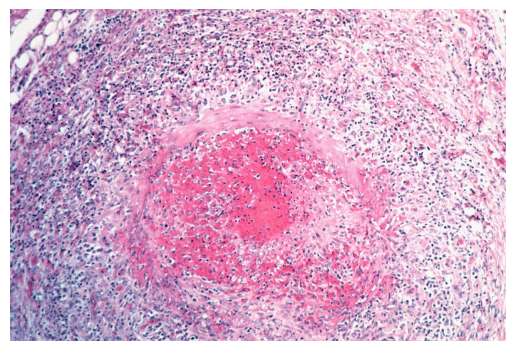

Question: Does this image show vasculitis, polyarteritis nodosa?
Actual Answer: yes
Predicted Answer: yes
Index 13



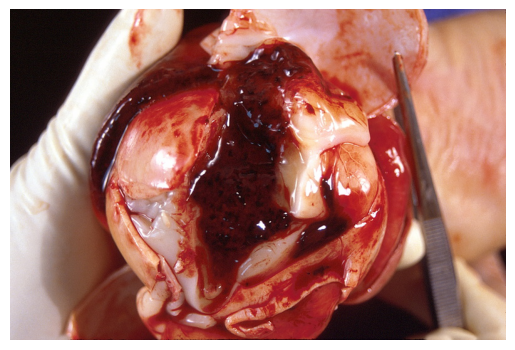

Question: What does this image show?
Actual Answer: giant cells and fibrosis
Predicted Answer: giant cells and fibrosis
Index 14



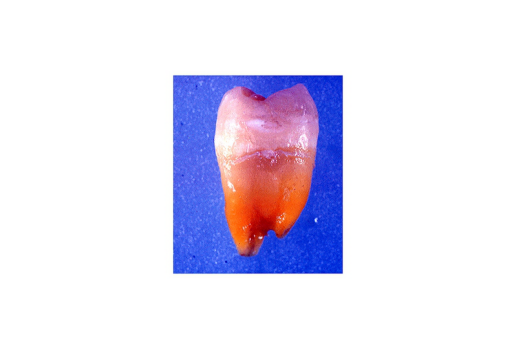

Question: Is tetracycline induced discoloration?
Actual Answer: yes
Predicted Answer: extremities
Index 15



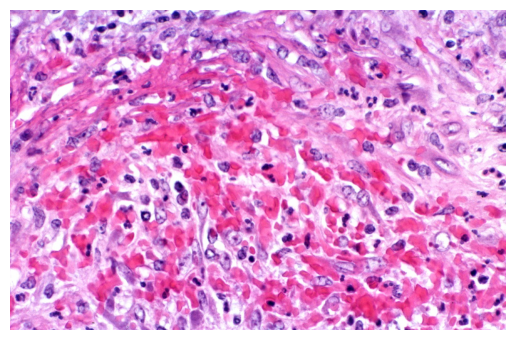

Question: Is beckwith-wiedemann syndrome present?
Actual Answer: no
Predicted Answer: no
Index 16



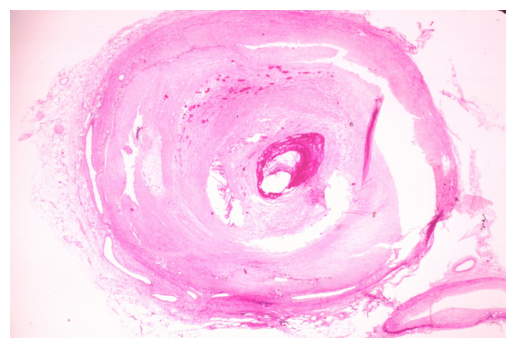

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 17



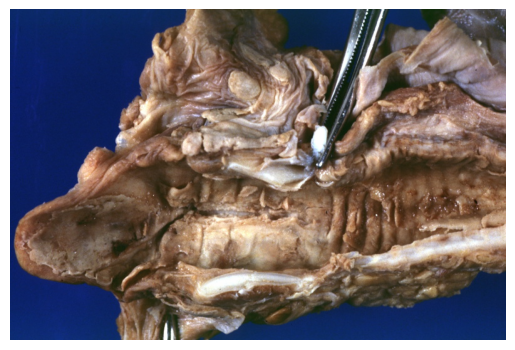

Question: Is larynx present?
Actual Answer: yes
Predicted Answer: yes
Index 18



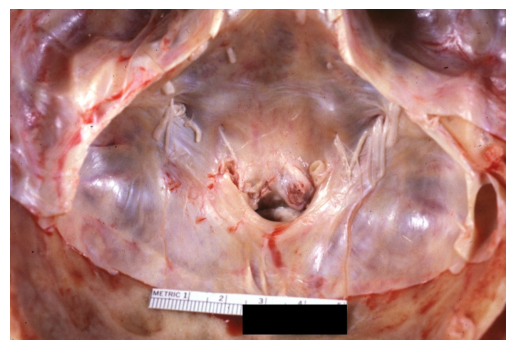

Question: What is present ?
Actual Answer: liver
Predicted Answer: sarcoidosis
Index 19



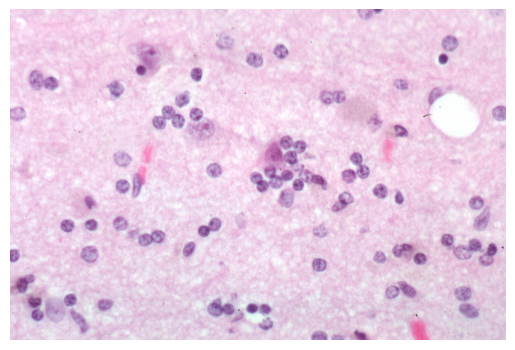

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 20



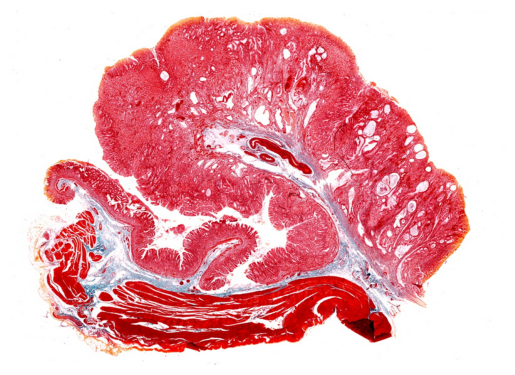

Question: Does this image show stomach, giant rugose hyperplasia?
Actual Answer: yes
Predicted Answer: yes
Index 21



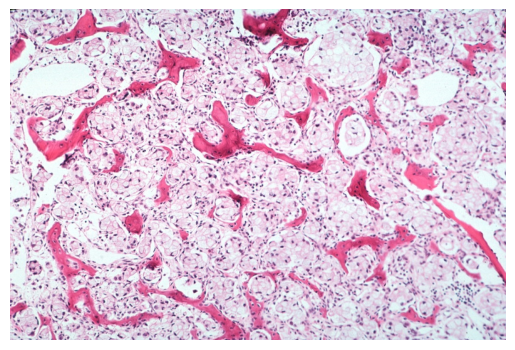

Question: Does this image show stomach primary?
Actual Answer: yes
Predicted Answer: yes
Index 22



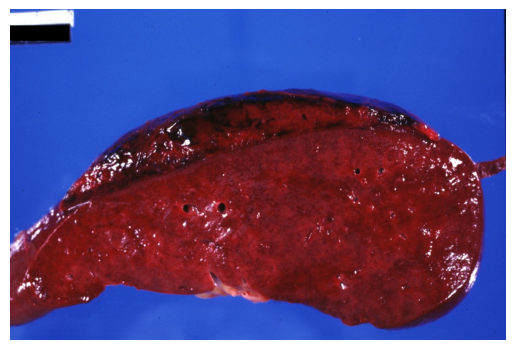

Question: Is foot present?
Actual Answer: no
Predicted Answer: no
Index 23



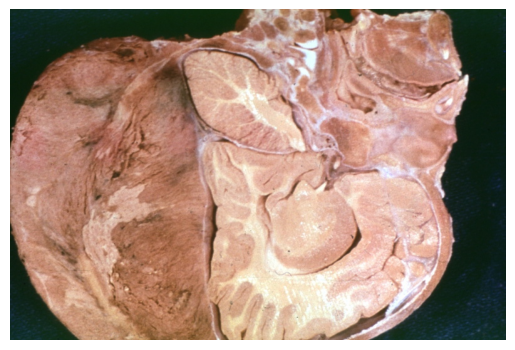

Question: What is present ?
Actual Answer: liver
Predicted Answer: sarcoidosis
Index 24



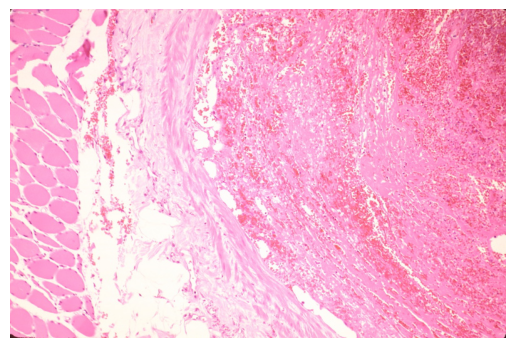

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 25



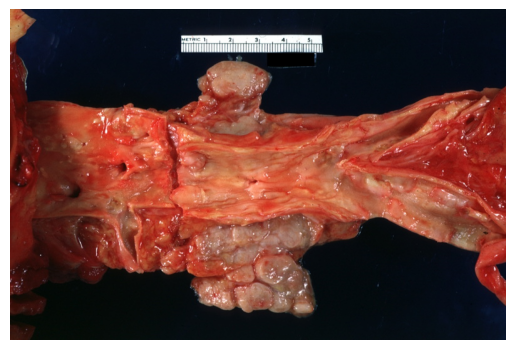

Question: Is lymph node present?
Actual Answer: yes
Predicted Answer: yes
Index 26



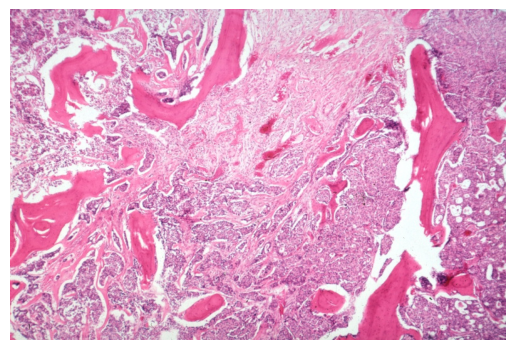

Question: What is islands of tumor?
Actual Answer: gross
Predicted Answer: two
Index 27



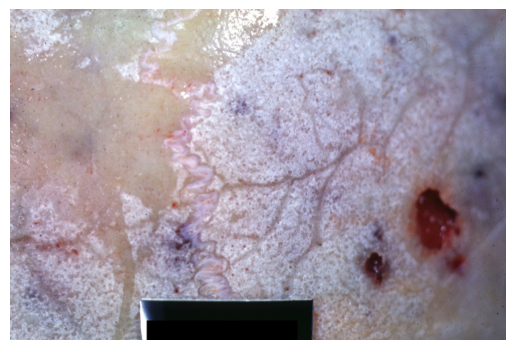

Question: Is multiple myeloma present?
Actual Answer: no
Predicted Answer: no
Index 28



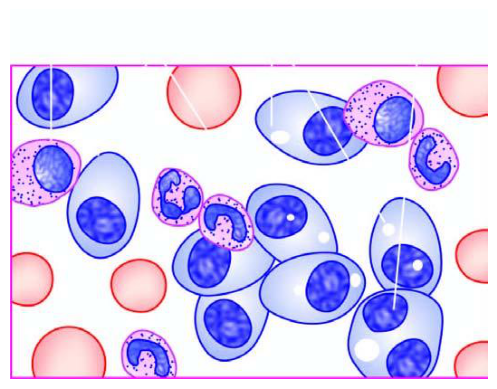

Question: Does one marrow aspirate in myeloma show numerous plasma cells, many with abnormal features?
Actual Answer: yes
Predicted Answer: heart
Index 29



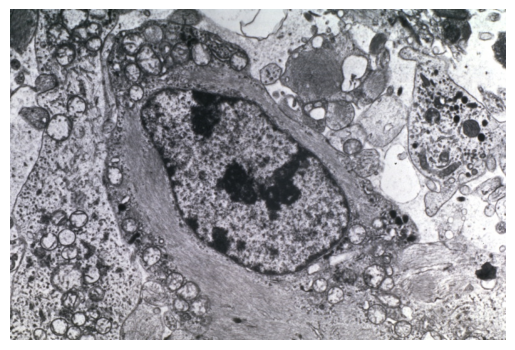

Question: What does this image show?
Actual Answer: giant cells and fibrosis
Predicted Answer: giant cells and fibrosis
Index 30



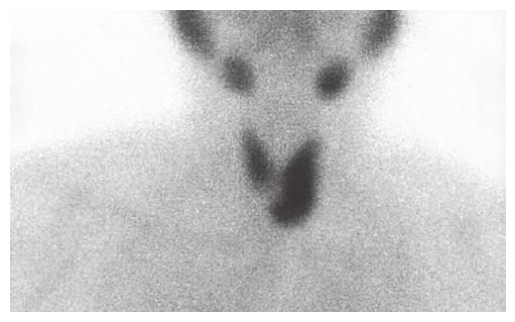

Question: What is useful in localizing and distinguishing adenomas from parathyroid hyperplasia,  in which more than one gland will demonstrate increased uptake?
Actual Answer: preoperative scintigraphy
Predicted Answer: heart
Index 31



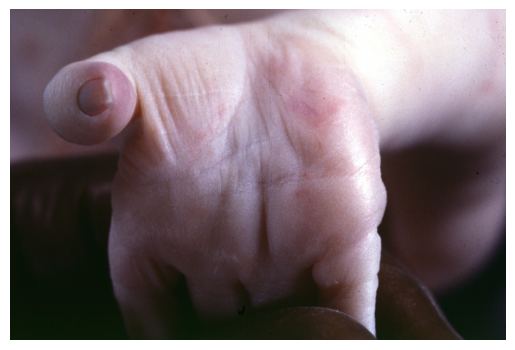

Question: Is palmar crease normal present?
Actual Answer: no
Predicted Answer: no
Index 32



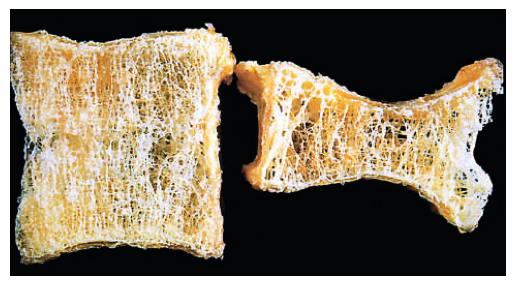

Question: Is steoporotic vertebral body shorten by compression fractures?
Actual Answer: yes
Predicted Answer: heart
Index 33



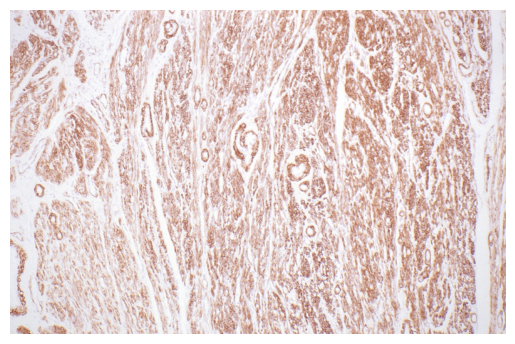

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 34



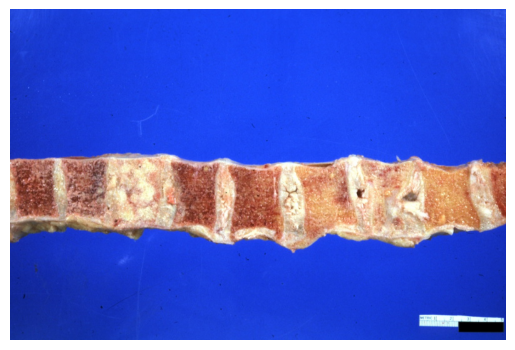

Question: What collapsed vertebra and one filled with neoplasm looks like Breast carcinoma but is an unclassified lymphoma?
Actual Answer: one
Predicted Answer: heart
Index 35



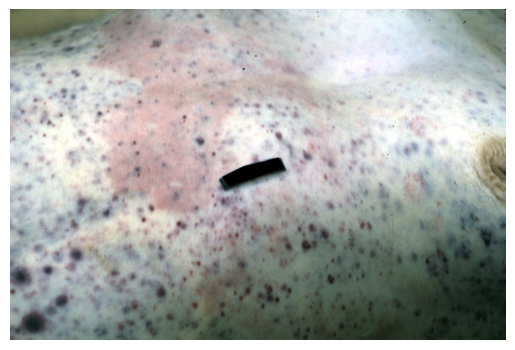

Question: Where is this?
Actual Answer: urinary
Predicted Answer: urinary
Index 36



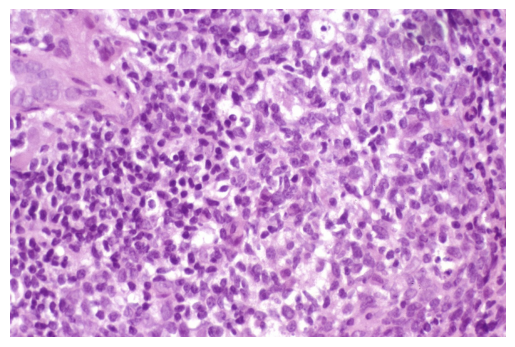

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 37



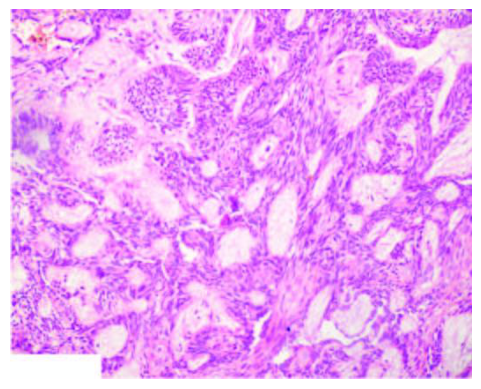

Question: Do the alveolar walls show irregular plexiform masses and network of strands of epithelial cells?
Actual Answer: no
Predicted Answer: two
Index 38



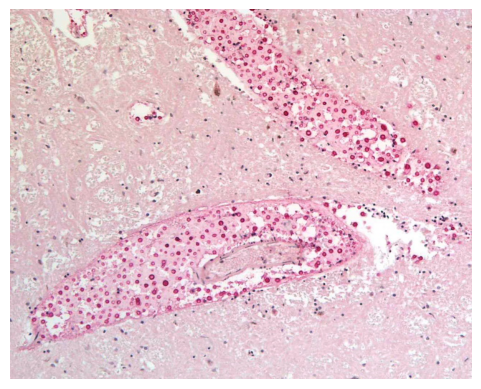

Question: Do seminoma stain?
Actual Answer: no
Predicted Answer: heart
Index 39



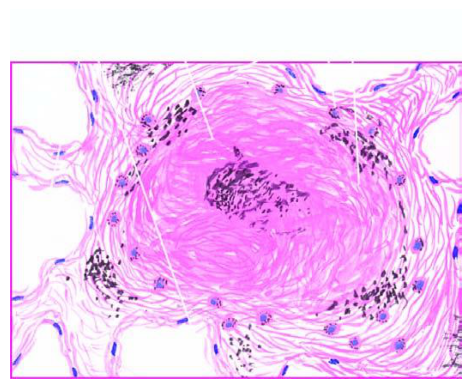

Question: Does the margin of the colony show bright fibres of silica?
Actual Answer: no
Predicted Answer: heart
Index 40



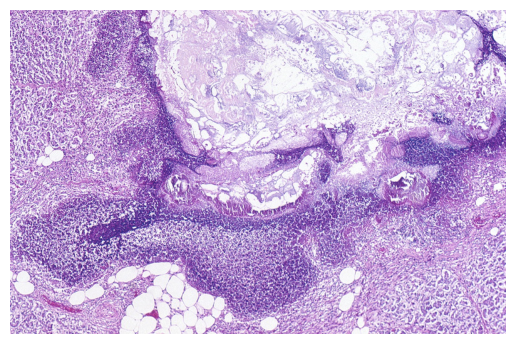

Question: Where is this?
Actual Answer: urinary
Predicted Answer: urinary
Index 41



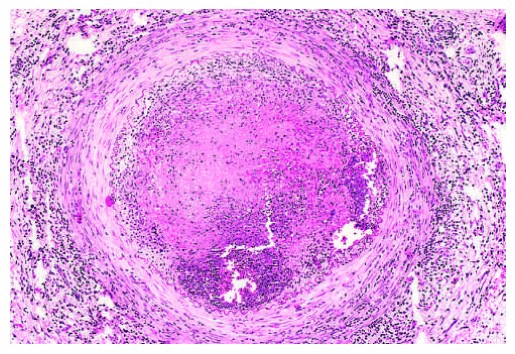

Question: Is the vessel wall infiltrated with leukocytes?
Actual Answer: yes
Predicted Answer: heart
Index 42



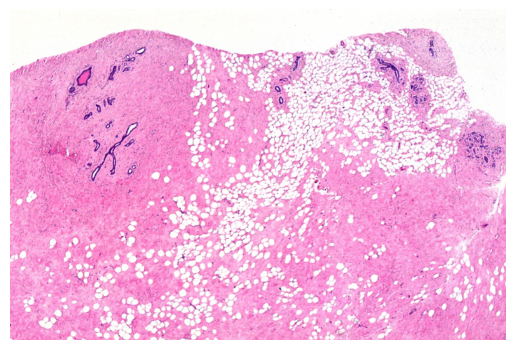

Question: Does this image show normal breast?
Actual Answer: yes
Predicted Answer: yes
Index 43



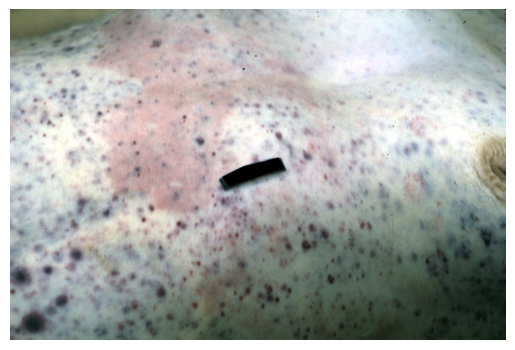

Question: Does this image show but not good color petechiae and purpura case of stcell leukemia?
Actual Answer: yes
Predicted Answer: yes
Index 44



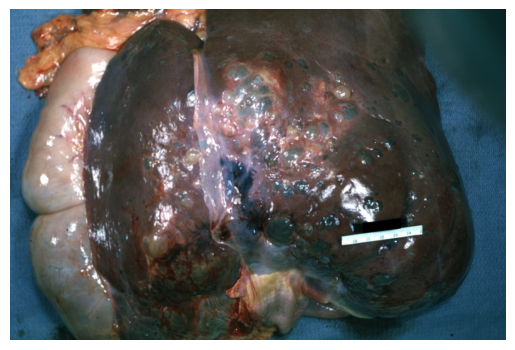

Question: Does this image show anterior view of removed and non-sectioned liver as surgeon would see thcase of polycystic disease?
Actual Answer: yes
Predicted Answer: yes
Index 45



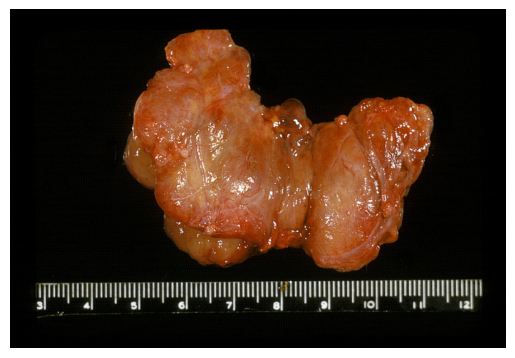

Question: What does this image show?
Actual Answer: giant cells and fibrosis
Predicted Answer: giant cells and fibrosis
Index 46



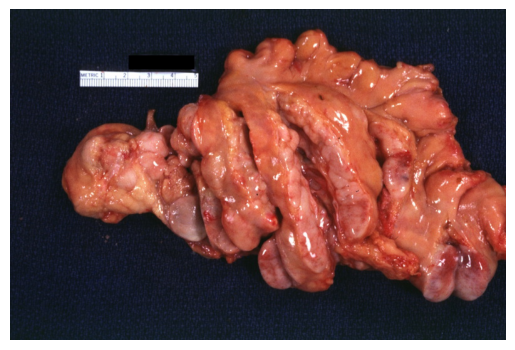

Question: What is present?
Actual Answer: sarcoidosis
Predicted Answer: sarcoidosis
Index 47



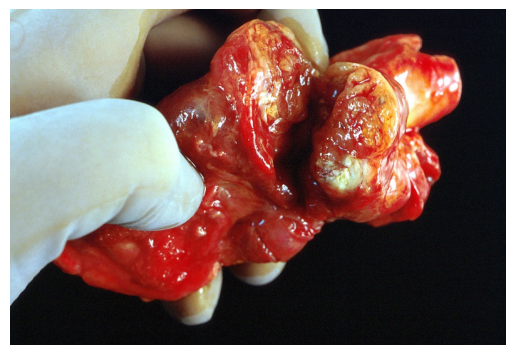

Question: Is adenocarcinoma present?
Actual Answer: yes
Predicted Answer: yes
Index 48



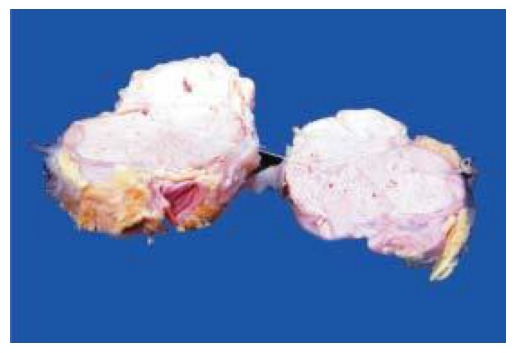

Question: What are there in the circumscribed nodular areas?
Actual Answer: areas of necrosis
Predicted Answer: heart
Index 49



In [19]:
import torch
from PIL import Image
from torchvision import transforms
from transformers import BertTokenizer
from torch.utils.data import DataLoader
import re

# Initialize BERT tokenizer
text_processor = BertTokenizer.from_pretrained('bert-base-uncased')

# Define transformations for images
data_transforms = {
    'any': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
}

def is_yes_no_question(question):
    patterns = [
        r'is\s+.*?\s+present\?',
        r'is\s+this\s+.*?\?',
        r'does\s+this\s+image\s+show\s+.*?\?',
        r'are\s+.*?\s+present\?'
    ]
    for pattern in patterns:
        if re.search(pattern, question, re.IGNORECASE):
            return True
    return False

# Function to create label mappings dynamically
def create_label_mappings(dataframe):
    label_to_answer = {}
    for index, row in dataframe.iterrows():
        label_to_answer[row['label']] = row['answer']
    return label_to_answer

# Define the label mappings using your dataset
label_mappings = create_label_mappings(inference_df)

# Create function for generating inference
def generate_inference(question, image_path, model_path):
    # Check if question is yes/no type or free form type
    is_yes_no = is_yes_no_question(question)

    # Load image and apply appropriate transformation
    image = Image.open(image_path).convert("RGB")
    image_transform = data_transforms['any'](image)
    image_tensor = image_transform.unsqueeze(0)

    # Tokenize the question
    encoding = text_processor(
        question,
        padding="max_length",
        truncation=True,
        max_length=32,
        return_tensors="pt"
    )
    input_ids = encoding['input_ids'].squeeze(0)
    attention_mask = encoding['attention_mask'].squeeze(0)

    # Initialize appropriate model based on question type
    model = VQAModel(num_classes)
    model = model.to(device)
    model.load_state_dict(torch.load(model_path))
    model.eval()

    # Generate inference
    with torch.no_grad():
        outputs = model(image_tensor.to(device), input_ids.unsqueeze(0).to(device), attention_mask.unsqueeze(0).to(device))
        _, predicted = torch.max(outputs.data, 1)
    
    # Decode the predicted label using label mappings
    predicted_answer = label_mappings.get(predicted.item(), "Unknown")

    # Display the image
    plt.imshow(image)
    plt.axis('off')
    plt.show()

    return predicted_answer

inference_dataset = VQADataset(df=inference_df, text_processor=text_processor, img_transform=data_transforms['any'])
inference_loader = DataLoader(inference_dataset, batch_size= 1)

print("Length of inference_loader:", len(inference_loader))
print("Length of inference_dataset:", len(inference_dataset))

num_iterations = 50

for i, (images, input_ids, attention_mask, labels) in enumerate(inference_loader):
    if i >= num_iterations:
        break  # Exit the loop after 100 iterations
    
    question = inference_dataset.df.iloc[i]['question']  # Extract question from dataset
    image_path = inference_dataset.df.iloc[i]['img_id'] + '.jpg'  # Extract image path from dataset
    actual_answer = inference_dataset.df.iloc[i]['answer']  # Extract actual answer from dataset

    model_path = 'vqa_model_yes_no.pth' if is_yes_no_question(question) else 'vqa_model_free_form.pth'

    # Generate inference
    prediction = generate_inference(question, image_path, model_path)

    # Print results
    print("Question:", question)
    print("Actual Answer:", actual_answer)
    print("Predicted Answer:", prediction)
    print("Index",i)
    print()